# **Lab 1.2 Image Visualization & Image Arithmetic Operation**

In [14]:
import cv2
import numpy as np
import math
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import mpl_toolkits
import os
import matplotlib.animation as animation
from IPython.display import HTML

### **Color Model Visualization**
In this part, you will explore and visualize different color models by separating and displaying each channel individually. The color models we will work with include RGB, HSV, HLS, and YCrCb.<br>

**HINT**: `cv2.cvtColor()`

Display each channel for each color model in RGB space use `direct slicing method (array[...])`.<br>
**Color model:**
- RGB
- HSV
- HLS
- YCrCb



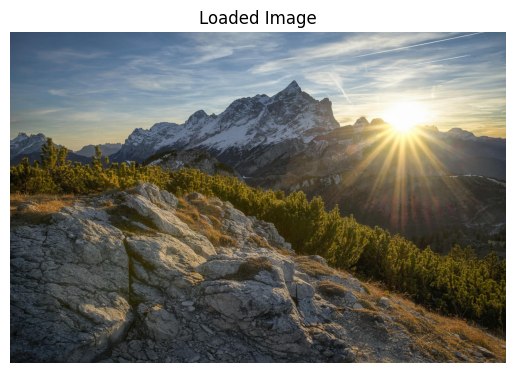

In [15]:
### START CODE HERE ###

img = cv2.imread("./asset/img2-1.jpg")
if img is not None:
	img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
	plt.imshow(img_rgb)
	plt.axis('off')
	plt.title('Loaded Image')
else:
	print("Error: Image not found or path is incorrect.")

### END CODE HERE ###

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image.png](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab1_image-representation/asset/2-1.png)

</details>

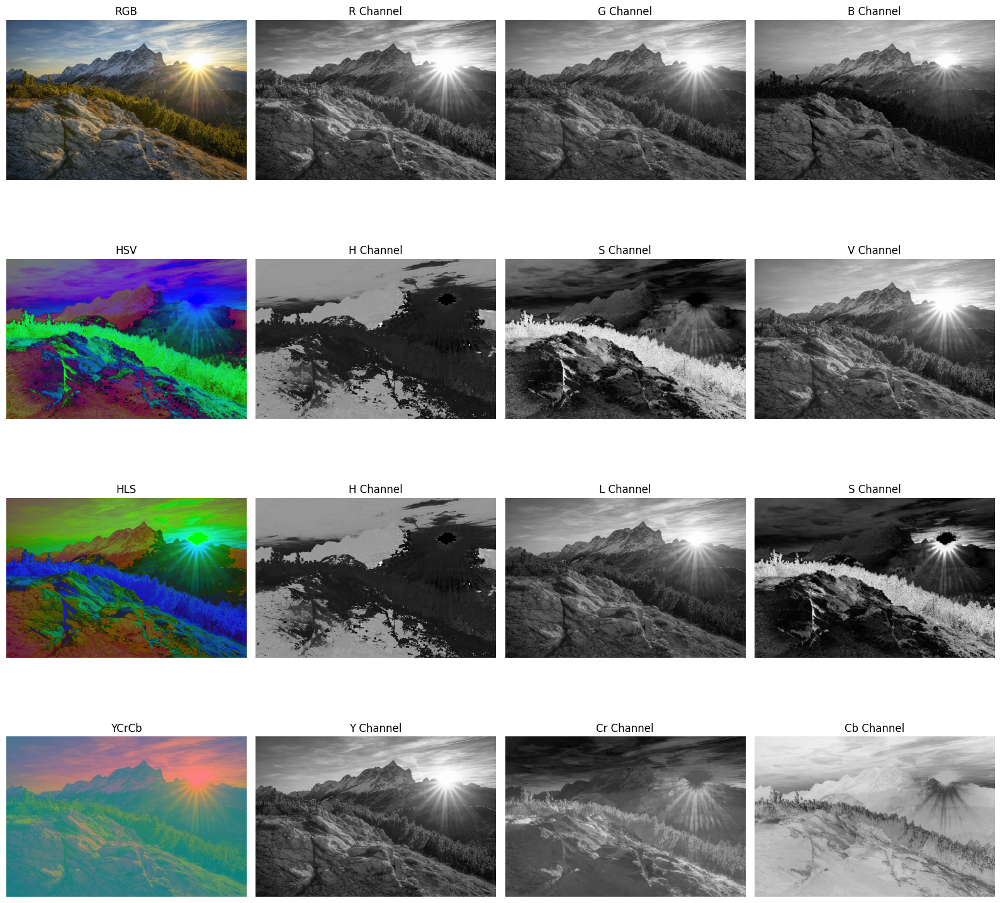

In [18]:
### START CODE HERE ###
fig, axs = plt.subplots(4, 4, figsize=(16, 16))

# Convert to different color spaces
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
img_hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
img_ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)

# Row 0: RGB
axs[0, 0].imshow(img_rgb)
axs[0, 0].set_title('RGB')
axs[0, 0].axis('off')

axs[0, 1].imshow(img_rgb[:,:,0], cmap='gray')
axs[0, 1].set_title('R Channel')
axs[0, 1].axis('off')

axs[0, 2].imshow(img_rgb[:,:,1], cmap='gray')
axs[0, 2].set_title('G Channel')
axs[0, 2].axis('off')

axs[0, 3].imshow(img_rgb[:,:,2], cmap='gray')
axs[0, 3].set_title('B Channel')
axs[0, 3].axis('off')

# Row 1: HSV
axs[1, 0].imshow(img_hsv)
axs[1, 0].set_title('HSV')
axs[1, 0].axis('off')

axs[1, 1].imshow(img_hsv[:,:,0], cmap='gray')
axs[1, 1].set_title('H Channel')
axs[1, 1].axis('off')

axs[1, 2].imshow(img_hsv[:,:,1], cmap='gray')
axs[1, 2].set_title('S Channel')
axs[1, 2].axis('off')

axs[1, 3].imshow(img_hsv[:,:,2], cmap='gray')
axs[1, 3].set_title('V Channel')
axs[1, 3].axis('off')

# Row 2: HLS
axs[2, 0].imshow(img_hls)
axs[2, 0].set_title('HLS')
axs[2, 0].axis('off')

axs[2, 1].imshow(img_hls[:,:,0], cmap='gray')
axs[2, 1].set_title('H Channel')
axs[2, 1].axis('off')

axs[2, 2].imshow(img_hls[:,:,1], cmap='gray')
axs[2, 2].set_title('L Channel')
axs[2, 2].axis('off')

axs[2, 3].imshow(img_hls[:,:,2], cmap='gray')
axs[2, 3].set_title('S Channel')
axs[2, 3].axis('off')

# Row 3: YCrCb
axs[3, 0].imshow(img_ycrcb)
axs[3, 0].set_title('YCrCb')
axs[3, 0].axis('off')

axs[3, 1].imshow(img_ycrcb[:,:,0], cmap='gray')
axs[3, 1].set_title('Y Channel')
axs[3, 1].axis('off')

axs[3, 2].imshow(img_ycrcb[:,:,1], cmap='gray')
axs[3, 2].set_title('Cr Channel')
axs[3, 2].axis('off')

axs[3, 3].imshow(img_ycrcb[:,:,2], cmap='gray')
axs[3, 3].set_title('Cb Channel')
axs[3, 3].axis('off')

plt.tight_layout()
plt.show()
### END CODE HERE ###

### **Images addition**
In this part, you will read two images using OpenCV and combine them using a weighted addition. You will explore how changing the weights affects the resulting image.

Read 2 images using OpenCV. Use your own images.

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image.png](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab1_image-representation/asset/2-2.png)

</details>

In [20]:
### START CODE HERE ###

img1 = cv2.imread("./asset/img2-1.jpg")
img2 = cv2.imread("./asset/img2-2.jpg")


### END CODE HERE ###

Complete `img_addition()` in the cell below.
$$
\begin{align*}
Im\_addition &= w_1Im_1+w_2Im_2 \\
w_1 + w_2 &= 1.0
\end{align*}
$$

In [24]:
### START CODE HERE ###
def img_addition(img1, img2, w1, w2):
    # Convert BGR to RGB
    img1_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    img2_rgb = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
    
    # Resize images to the same dimensions (use the smaller dimensions)
    h1, w1_dim, _ = img1_rgb.shape
    h2, w2_dim, _ = img2_rgb.shape
    
    # Use the minimum dimensions to avoid upscaling
    target_height = min(h1, h2)
    target_width = min(w1_dim, w2_dim)
    
    # Resize both images to the target dimensions
    img1_resized = cv2.resize(img1_rgb, (target_width, target_height))
    img2_resized = cv2.resize(img2_rgb, (target_width, target_height))
    
    # Perform weighted addition
    result = cv2.addWeighted(img1_resized, w1, img2_resized, w2, 0)
    
    return result
### END CODE HERE ###

If you code work properly, the cell below should run without error.

In [25]:
a = np.full((20, 20), 255, dtype=np.uint8)
b = np.full((20, 20), 255, dtype=np.uint8)
test_result = img_addition(a, b, 1, 1)
assert np.min(test_result) >= 0 and np.max(test_result) <= 255, \
    f"Pixel value out of range: min={np.min(test_result)}, max={np.max(test_result)}"

Use the `img_addition()` function here and save the result to an array for creating a video in a later part. Use weight values in the range [0, 1] with ***at least 20 steps***, ***first increasing from 0 to 1 and then decreasing from 1 back to 0***.

Generated 41 frames
Weight sequence: 21 up + 20 down = 41 total
First few weights: [0.   0.05 0.1  0.15 0.2 ]
Last few weights: [0.2  0.15 0.1  0.05 0.  ]


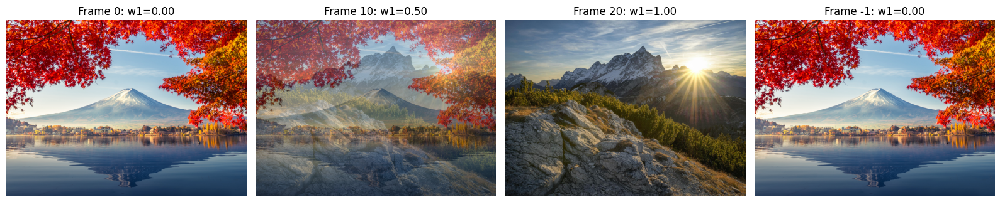

In [26]:
### START CODE HERE ###

# Create weight sequence: 0 -> 1 -> 0 with at least 20 steps
steps = 21  # This gives us 21 steps for each direction (42 total frames)

# Create ascending weights (0 to 1)
weights_up = np.linspace(0, 1, steps)
# Create descending weights (1 to 0, excluding the duplicate 1)
weights_down = np.linspace(1, 0, steps)[1:]  # Skip first element to avoid duplicate

# Combine both sequences
all_weights = np.concatenate([weights_up, weights_down])

# Create array to store all images for video
image_frames = []

# Generate all frames
for w1 in all_weights:
    w2 = 1 - w1  # Ensure w1 + w2 = 1
    blended_img = img_addition(img1, img2, w1, w2)
    image_frames.append(blended_img)

# Convert to numpy array for easier handling
image_frames = np.array(image_frames)

print(f"Generated {len(image_frames)} frames")
print(f"Weight sequence: {len(weights_up)} up + {len(weights_down)} down = {len(all_weights)} total")
print(f"First few weights: {all_weights[:5]}")
print(f"Last few weights: {all_weights[-5:]}")

# Display a few sample frames to verify
fig, axes = plt.subplots(1, 4, figsize=(16, 4))
sample_indices = [0, len(all_weights)//4, len(all_weights)//2, -1]
for i, idx in enumerate(sample_indices):
    axes[i].imshow(image_frames[idx])
    axes[i].set_title(f'Frame {idx}: w1={all_weights[idx]:.2f}')
    axes[i].axis('off')

plt.tight_layout()
plt.show()

### END CODE HERE ###

Save the array of images to a video. Please complete the function below.

In [27]:
### START CODE HERE ###
def write_images_to_video(image_array, output_file, frame_rate=30):

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for MP4 format
    height, width, _ = image_array[0].shape
    out = cv2.VideoWriter(output_file, fourcc, frame_rate, (width, height))

    
### END CODE HERE ###

Use `write_images_to_video()` and save the result.

In [31]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_image_add.mp4")
write_images_to_video(image_frames, output_file, frame_rate=30)

Now use `matplotlib.animation` to display the animation from the images array.

In [32]:
%%capture
### START CODE HERE ###

# Create a new figure for the animation
fig, ax = plt.subplots(figsize=(8, 6))
ax.axis('off')

# Create list of artists (each frame should be a list containing the imshow object)
artists = []
for frame in image_frames:
    im = ax.imshow(frame, animated=True)
    artists.append([im])  # Each frame needs to be a list of artists

# Create animation
ani = animation.ArtistAnimation(fig, artists, interval=1000/30, blit=True, repeat=True)

### END CODE HERE ###

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![addition-2.gif](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab1_image-representation/asset/addition.gif)

</details>

In [33]:
display(HTML(ani.to_jshtml()))

Animation size has reached 21529327 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### **Image Bitwise AND operation**
Complete the `create_image_mask()` function in the cell below. Use `np.zeros()` and fill the desired area with 255. This function will return a mask.

In [48]:
### START CODE HERE ###
def create_image_mask(height, width, x, y):
    # Create a black mask (all zeros)
    image_mask = np.zeros((height, width), dtype=np.uint8)
    
    # Create a white rectangle at the specified position
    cv2.rectangle(image_mask, (x, y), (x + 100, y + 100), 255, -1)  # Draw a white rectangle
    
    return image_mask
### END CODE HERE ###

Use your `create_image_mask()` here and display your mask.
<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image.png](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab1_image-representation/asset/2-3.png)

</details>

Text(0.5, 1.0, 'Mask')

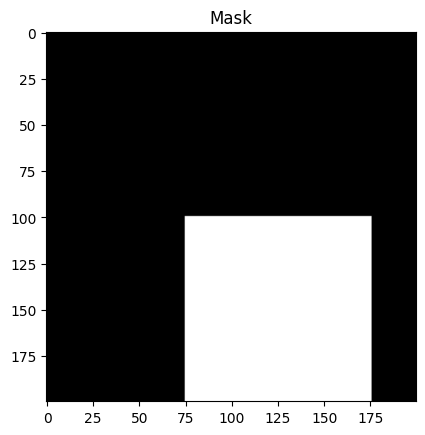

In [51]:
### START CODE HERE ###
   
image_mask = create_image_mask(height=200, width=200, x=75, y=100)
plt.imshow(image_mask,cmap='gray')
plt.title('Mask')
### END CODE HERE ###

Perform the bitwise AND operation between the image and the mask. Then, display the output as shown in the reference image below.

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image.png](https://raw.githubusercontent.com/Digital-Image-Processing-Laboratory/Image-Processing-Course-2025/main/Lab1_image-representation/asset/2-4.png)

</details>

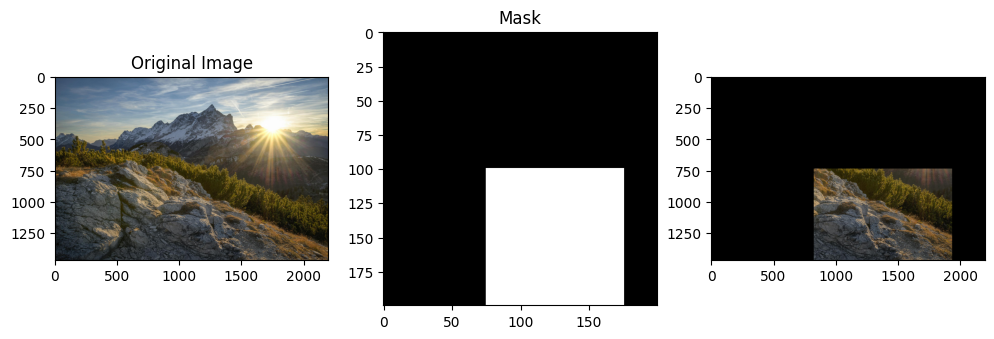

In [53]:
### START CODE HERE ###
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
#Original
axs[0].imshow(img_rgb)
axs[0].set_title('Original Image')

#Mask
axs[1].imshow(image_mask, cmap='gray')
axs[1].set_title('Mask')

#Bitwise AND
# Resize mask to match img_rgb shape
mask_resized = cv2.resize(image_mask, (img_rgb.shape[1], img_rgb.shape[0]), interpolation=cv2.INTER_NEAREST)
bitwise_and_result = cv2.bitwise_and(img_rgb, img_rgb, mask=mask_resized)
axs[2].imshow(bitwise_and_result)


plt.show()
### END CODE HERE ###

---

## **Question**
1. When performing image subtraction, how does the order of the images (im1-im2 vs. im2-im1) affect the  resulting image?
2. If we want to censor a part of an image, explain your designed mask and the process using logic operation.
3. How would we obtain background of the scene if there are objects moving all the time and some objects moving very slow and sometimes stay still?